In [27]:
import os
import pandas as pd
import sys
import numpy as np
import math
from scipy.signal import resample
from scipy.signal import medfilt
from scipy import interpolate
import matplotlib.pyplot as plt

sys.path.append(os.path.dirname(os.getcwd())) 

from utils.syncUtilities import getSamplesToSynchronize, SynchronizeAndCutSignals
import utils.signalProcessing as signalutil
import utils.fileProcessing as fileutil
import utils.plotUtilities as plotutil
import utils.signalProcessing as sp

In [28]:
fulldatasetpath = '/Volumes/Data_Drive/datasets/VIDIMU'
inpath = os.path.join(fulldatasetpath,'dataset','videoandimusyncrop')
croppath = os.path.join(fulldatasetpath,'dataset','videoandimusyncrop')

In [29]:
subjects = ["S40","S41","S42",  "S44",  "S46","S47","S48","S49",
            "S50","S51","S52","S53","S54","S55","S56","S57"]

lower_activities = ["A01","A02","A03","A04"]
upper_activities = ["A05","A06","A07","A08","A09","A10","A11","A12","A13"]

dataset_activities = lower_activities + upper_activities

activities_legend = ["walk_forward", "walk_backward", "walk_along","sit_to_stand",
                    "move_right_arm","move_left_arm","drink_right_arm","drink_left_arm", 
                    "assemble_both_arms","throw_both_arms","reachup_right_arm","reachup_left_arm",
                    "tear_both_arms"]

motsignals_range = {

    'pelvis_tilt': (-90, 90),
    'pelvis_list': (-90, 90),
    # 'pelvis_rotation': ("unclamped"),
    # 'pelvis_tx': (),
    # 'pelvis_ty': (),
    # 'pelvis_tz': (),

    'hip_flexion_r': (-30, 120),
    'hip_adduction_r': (-50, 30),
    'hip_rotation_r': (-60, 40),
    'knee_angle_r':(-20,120),
    'knee_angle_r_beta':(-20,120),
    # 'ankle_angle_r': (),
    # 'subtalar_angle_r': (),
    # 'mtp_angle_r': (),

    'hip_flexion_l': (-30, 120),
    'hip_adduction_l': (-50, 30),
    'hip_rotation_l': (-60, 40),
    'knee_angle_l':(-20,120),
    'knee_angle_l_beta':(-20,120),
    # 'ankle_angle_l': (),
    # 'subtalar_angle_l': (),
    # 'mtp_angle_l': (),

    'lumbar_extenson': (-90, 90),
    'lumbar_bending': (-90, 90),
    'lumbar_rotation': (-90, 90),

    'arm_flex_r':(-90,180),
    'arm_add_r':(-180, 90),
    'arm_rot_r':(-90, 100),
    'elbow_flex_r':(-10,180),
    'pro_sup_r': (-10, 180),
    # 'wrist_flex_r': (),
    # 'wrist_dev_r': (),

    'arm_flex_l':(-90,180),
    'arm_add_l':(-180, 90),
    'arm_rot_l':(-90, 100),
    'elbow_flex_l':(-10,180),
    'pro_sup_l': (-10, 180),
    # 'wrist_flex_l': (),
    # 'wrist_dev_l': (),
}

### Pelvis
- **`pelvis_tilt`**: Represents the forward and backward tilt of the pelvis.  
  - *Example*: When you perform a pelvic tilt exercise, where you tilt your pelvis forward (anterior tilt) and backward (posterior tilt).

- **`pelvis_list`**: Refers to the sideways tilt of the pelvis.  
  - *Example*: When one hip is higher than the other while standing on one leg.

- **`pelvis_rotation`**: Represents the rotation of the pelvis around a vertical axis (yaw).  
  - *Example*: When you rotate your pelvis while swinging a golf club or dancing.

- **`pelvis_tx`, `pelvis_ty`, `pelvis_tz`**: These typically refer to the translation or movement of the pelvis in the x, y, and z axes, respectively (forward/backward, up/down, and side-to-side).  
  - *Example*: When walking, the pelvis shifts slightly forward, upward, and side-to-side.

### Lower Limbs
#### Right Leg
- **`hip_flexion_r`**: Flexion and extension of the right hip joint.  
  - *Example*: Flexion occurs when you lift your right knee toward your chest; extension happens when you bring it back down.

- **`hip_adduction_r`**: Movement of the right thigh toward or away from the midline of the body.  
  - *Example*: Bringing the right leg inward toward the left leg (adduction) or moving it outward (abduction).

- **`hip_rotation_r`**: Internal and external rotation of the right hip.  
  - *Example*: Turning your right foot inward or outward while standing.

- **`knee_angle_r`** and **`knee_angle_r_beta`**: These usually represent flexion and extension of the right knee.  
  - *Example*: Bending the right knee during a squat (flexion) or straightening it when standing up.

- **`ankle_angle_r`**: Flexion (dorsiflexion) and extension (plantarflexion) of the right ankle.  
  - *Example*: Lifting the right foot upwards (dorsiflexion) or pointing the toes downward (plantarflexion).

- **`subtalar_angle_r`**: Represents movements of the subtalar joint, which allow the foot to tilt inward (inversion) or outward (eversion).  
  - *Example*: Tilting the right foot inward or outward while standing.

- **`mtp_angle_r`**: Movement at the metatarsophalangeal joint (toe flexion and extension).  
  - *Example*: Curling the right toes downward or lifting them upward.

#### Left Leg
- **`hip_flexion_l`, `hip_adduction_l`, `hip_rotation_l`**: These are the same as the right leg but refer to the left hip.  
  - *Example*: Lifting the left knee toward the chest (hip flexion), bringing the left leg inward (adduction), or rotating the foot inward or outward (rotation).

- **`knee_angle_l`** and **`knee_angle_l_beta`**: Flexion and extension of the left knee.  
  - *Example*: Bending and straightening the left leg during lunges.

- **`ankle_angle_l`, `subtalar_angle_l`, `mtp_angle_l`**: Similar to the right leg, these refer to movements in the left ankle and foot joints.  
  - *Example*: Lifting the left foot upwards (dorsiflexion) or tilting the foot inward (inversion).

### Spine and Lumbar
- **`lumbar_extension`**: Forward and backward bending of the lumbar spine.  
  - *Example*: Arching the lower back during a yoga backbend.

- **`lumbar_bending`**: Sideways bending of the lumbar spine.  
  - *Example*: Leaning to the left or right while standing.

- **`lumbar_rotation`**: Twisting or rotating the lumbar spine.  
  - *Example*: Rotating the torso while performing a seated twist.

### Upper Limbs
#### Right Arm
- **`arm_flex_r`**: Flexion and extension of the right shoulder.  
  - *Example*: Raising the right arm in front of the body (flexion) or bringing it back down (extension).

- **`arm_add_r`**: Adduction and abduction of the right shoulder.  
  - *Example*: Bringing the right arm across the body (adduction) or raising it out to the side (abduction).

- **`arm_rot_r`**: Internal and external rotation of the right shoulder.  
  - *Example*: Rotating the right arm inward or outward, as when reaching behind your back.

- **`elbow_flex_r`**: Flexion and extension of the right elbow.  
  - *Example*: Bending the right elbow to bring the hand closer to the shoulder (flexion) or straightening the arm (extension).

- **`pro_sup_r`**: Pronation and supination of the right forearm.  
  - *Example*: Turning the right palm up (supination) or down (pronation).

- **`wrist_flex_r`**: Flexion and extension of the right wrist.  
  - *Example*: Bending the right wrist upward (dorsiflexion) or downward (flexion).

- **`wrist_dev_r`**: Ulnar and radial deviation of the right wrist.  
  - *Example*: Moving the right wrist inward (ulnar deviation) or outward (radial deviation).

#### Left Arm
- **`arm_flex_l`, `arm_add_l`, `arm_rot_l`**: Same movements as the right arm but for the left shoulder.  
  - *Example*: Raising the left arm to the side (abduction) or rotating it inward.

- **`elbow_flex_l`**: Flexion and extension of the left elbow.  
  - *Example*: Curling the left arm during a bicep curl.

- **`pro_sup_l`**: Pronation and supination of the left forearm.  
  - *Example*: Rotating the left palm up or down.

- **`wrist_flex_l`, `wrist_dev_l`**: Flexion/extension and deviation of the left wrist.  
  - *Example*: Bending the wrist upward or moving it side to side.

In [30]:
def mot_df(motpth):
    # Initialize a list to store the header
    header = []
    
    # Open the file and manually read the header lines
    with open(motpth, 'r') as f:
        for i, line in enumerate(f):
            # Stop reading the header at the data section (after 6th line)
            if i < 6:
                header.append(line.strip())  # Append each header line
            else:
                break
    
    # Now read the data part of the .mot file, skipping the first 6 lines (the header)
    df = pd.read_csv(motpth, sep='\s+', comment='#', header=6)  # Adjust `header=6` based on the file structure
    
    return df, header

<>:15: SyntaxWarning: invalid escape sequence '\s'
<>:15: SyntaxWarning: invalid escape sequence '\s'
/var/folders/fp/1nfx148n1js1jxdspmc7mb9r0000gn/T/ipykernel_12280/2177869853.py:15: SyntaxWarning: invalid escape sequence '\s'
  df = pd.read_csv(motpth, sep='\s+', comment='#', header=6)  # Adjust `header=6` based on the file structure


In [31]:
def write_mot_file(df, header, filepath):
    # Open the file in write mode
    with open(filepath, 'w') as f:
        # Step 1: Write the header lines
        for line in header:
            f.write(line + '\n')  # Ensure each header line is followed by a newline
        
        # Step 2: Write the column headers from the DataFrame
        f.write('\t'.join(df.columns) + '\n')  # Write the DataFrame column names as the header
        
        # Step 3: Write the data from the DataFrame
        for row in df.itertuples(index=False, name=None):
            # Apply custom formatting for each value in the row
            row_str = '\t'.join(format_value(val) for val in row)
            f.write(row_str + '\n')

def format_value(val):
    """
    Custom formatting function to match the original .mot file precision.
    - If the value is a float, retain 12 significant digits for the float.
    - If the value is essentially an integer (like 0), don't display decimal places.
    """
    if isinstance(val, float):
        if val.is_integer():  # If the float is essentially an integer, return it without decimal places
            return f'{int(val)}'
        else:  # Return with a specific precision (up to 12 significant digits to match the original)
            return f'{val:.12f}'.rstrip('0').rstrip('.')  # Stripping trailing zeros and unnecessary dots
    else:
        return str(val)

def validate_mot_file(original_filepath, output_filepath, tolerance=1e-6):
    """
    Compare the original .mot file with the output file, allowing for floating-point differences up to the specified tolerance.
    """
    with open(original_filepath, 'r') as original_file, open(output_filepath, 'r') as output_file:
        original_lines = original_file.readlines()
        output_lines = output_file.readlines()

        # Check if the number of lines matches
        if len(original_lines) != len(output_lines):
            print(f"Files have different numbers of lines. Original: {len(original_lines)}, Output: {len(output_lines)}")
            return False

        # Iterate line by line and compare
        for i, (orig_line, out_line) in enumerate(zip(original_lines, output_lines)):
            # Split each line into individual values (assuming tab separation)
            orig_values = orig_line.strip().split('\t')
            out_values = out_line.strip().split('\t')

            if len(orig_values) != len(out_values):
                print(f"Line {i+1} has different numbers of columns. Original: {len(orig_values)}, Output: {len(out_values)}")
                return False

            # Compare each value in the line
            for j, (orig_val, out_val) in enumerate(zip(orig_values, out_values)):
                try:
                    orig_float = float(orig_val)
                    out_float = float(out_val)
                    
                    # Compare floats with tolerance
                    if not math.isclose(orig_float, out_float, abs_tol=tolerance):
                        print(f"Difference found on line {i+1}, column {j+1}:")
                        print(f"Original: {orig_val}, Output: {out_val}")
                        return False
                except ValueError:
                    # If the value cannot be converted to float, compare them as strings (for headers or other non-float values)
                    if orig_val != out_val:
                        print(f"Difference found on line {i+1}, column {j+1}:")
                        print(f"Original: {orig_val}, Output: {out_val}")
                        return False

    print("The files match within the specified tolerance.")
    return True

In [32]:
def raw_df(pth):
    df = pd.read_csv(pth, sep=',', header=0)
    # Step 1: Create new columns for each quaternion
    df['quaternion_w'] = df['QUAT'] + '_w'
    df['quaternion_x'] = df['QUAT'] + '_x'
    df['quaternion_y'] = df['QUAT'] + '_y'
    df['quaternion_z'] = df['QUAT'] + '_z'
    
    # Step 2: Set the timestamp as the index, but keep it as a column for grouping
    df.reset_index(inplace=True)

    # Step 3: Reshape the dataframe - pivot the quaternion data
    # Prepare the data by reshaping it based on the 'label' and 'timestamp'
    df_pivot_w = df.pivot(index='timestamp', columns='quaternion_w', values='w')
    df_pivot_x = df.pivot(index='timestamp', columns='quaternion_x', values='x')
    df_pivot_y = df.pivot(index='timestamp', columns='quaternion_y', values='y')
    df_pivot_z = df.pivot(index='timestamp', columns='quaternion_z', values='z')

    # Step 4: Combine the pivoted dataframes
    df_final = pd.concat([df_pivot_w, df_pivot_x, df_pivot_y, df_pivot_z], axis=1)
    
    # Reset the index so that timestamp is the first column again
    df_final.reset_index(inplace=True)
    
    return df_final    
    
# raw_file = raw_df('/Volumes/Data_Drive/datasets/VIDIMU/dataset/videoandimusync/S40/S40_A03_T02.raw')
# len(raw_file['timestamp'].unique())

In [33]:
def crop_dfs(df_imu, df_vid):
    # Calculate the minimum duration in seconds between the two datasets
    min_duration = min(len(df_imu) / 50, len(df_vid) / 30)
    
    # Calculate the number of rows to retain in both DataFrames
    imu_rows = int(round(min_duration * 50))  # Number of IMU samples at 50Hz
    vid_rows = int(round(min_duration * 30))  # Number of Video samples at 30Hz
    
    # Crop the DataFrames to match the time duration
    df_imu_cropped = df_imu.iloc[:imu_rows]  # Crop IMU data
    df_vid_cropped = df_vid.iloc[:vid_rows]  # Crop Video data
    
    return df_imu_cropped, df_vid_cropped


def validate_cropped_signals(df_imu, df_vid):
    # Calculate durations
    duration_imu = len(df_imu) / 50  # IMU signal sampled at 50 Hz
    duration_vid = len(df_vid) / 30  # Video signal sampled at 30 Hz
    
    # Tolerance for time difference
    tolerance = 1.5e-2  # Tolerance of 15 milliseconds
    
    # Calculate the difference in durations
    time_difference = abs(duration_imu - duration_vid)
    
    # Check if the difference is within tolerance
    if time_difference < tolerance:
        print("The signals are approximately the same length.")
    else:
        print(f"Warning: The signals differ in length by {time_difference:.4f} seconds.")
    
    # Print the durations for reference
    print(f"Duration of IMU signal: {duration_imu:.4f} seconds")
    print(f"Duration of Video signal: {duration_vid:.4f} seconds")

In [34]:
for activity in dataset_activities:
    print("Activity: " + activity)
    for subj in subjects:
        print('\tSubject:', subj)
        for trial in ["T01", "T02", "T03", "T04", "T05"]:
            vidpth = os.path.join(inpath, subj, subj + '_' + activity + '_' + trial + '.csv')
            imupth = os.path.join(inpath, subj, 'ik_' + subj + '_' + activity + '_' + trial + '.mot')

            vid_exists = os.path.exists(vidpth)
            imu_exists = os.path.exists(imupth)

            if not vid_exists and not imu_exists:
                # print(f'\t\tNo files found for {subj}, {activity}, {trial}')
                continue


            # Continue with loading data if files exist
            if imu_exists:
                imu_df, imu_head = mot_df(imupth)
                # imu_df = raw_df(imupth)
            if vid_exists:
                vid_df = pd.read_csv(vidpth)

            # if imu_exists and vid_exists:
                # mycrop = False
                # if mycrop:
                #     imu_df, vid_df = crop_dfs(imu_df, vid_df)
                #     write_mot_file(imu_df, imu_head, os.path.join(croppath, subj, 'ik_' + subj + '_' + activity + '_' + trial + '.mot'))
                #     vid_df.to_csv(os.path.join(croppath, subj, subj + '_' + activity + '_' + trial + '.csv'))

            validate_cropped_signals(imu_df, vid_df)

Activity: A01
	Subject: S40
The signals are approximately the same length.
Duration of IMU signal: 36.3000 seconds
Duration of Video signal: 36.3000 seconds
	Subject: S41
The signals are approximately the same length.
Duration of IMU signal: 37.0800 seconds
Duration of Video signal: 37.0667 seconds
	Subject: S42
The signals are approximately the same length.
Duration of IMU signal: 41.7000 seconds
Duration of Video signal: 41.7000 seconds
	Subject: S44
The signals are approximately the same length.
Duration of IMU signal: 54.8400 seconds
Duration of Video signal: 54.8333 seconds
	Subject: S46
The signals are approximately the same length.
Duration of IMU signal: 31.0600 seconds
Duration of Video signal: 31.0667 seconds
	Subject: S47
The signals are approximately the same length.
Duration of IMU signal: 53.3600 seconds
Duration of Video signal: 53.3667 seconds
	Subject: S48
The signals are approximately the same length.
Duration of IMU signal: 48.1000 seconds
Duration of Video signal: 4

In [35]:
def getMainJointFromMotAndMainBonesFromCSV(dfcsv):
    joints = [
        'pelvis', 'left_hip', 'right_hip', 'torso', 'neck',
        'left_knee', 'right_knee', 'left_ankle', 'right_ankle',
        'left_shoulder', 'right_shoulder', 'left_elbow', 'right_elbow',
        'left_wrist', 'right_wrist', 'left_big_toe', 'right_big_toe',
        'left_small_toe', 'right_small_toe', 'left_heel', 'right_heel',
        'nose', 'left_eye', 'right_eye', 'left_ear', 'right_ear',
        'left_pinky_knuckle', 'right_pinky_knuckle', 'left_middle_tip', 'right_middle_tip',
        'left_index_knuckle', 'right_index_knuckle', 'left_thumb_tip', ' right_thumb_tip'
    ]

    jointMot = {joint: dfcsv[[f'{joint}_x', f'{joint}_y', f'{joint}_z']].to_numpy() for joint in joints}
    return jointMot


In [36]:
jointDict = {"knee_angle_r":['right_hip', 'right_knee','right_knee','right_ankle'],
    "knee_angle_l":['left_hip', 'left_knee', 'left_knee', 'left_ankle'],
    "elbow_flex_r":['right_shoulder', 'right_elbow', 'right_elbow', 'right_wrist'],
    "elbow_flex_l":['left_shoulder', 'left_elbow', 'left_elbow', 'left_wrist'],
    "arm_flex_r":['right_shoulder', 'right_elbow', 'neck', 'torso'],
    "arm_flex_l":['left_shoulder', 'left_elbow', 'neck', 'torso']}

jointKeys = list(jointDict.keys())

def getJointAngleMotAsNP(dfmot,jointDict):
    jointangle_mot = dfmot[list(jointDict.keys())].to_numpy()#.flatten()[1:]
    # print('jointangle_mot shape:', jointangle_mot.shape)
    return jointangle_mot

def getJointAngleCsvAsNP(dfcsv, jointDict):
    bonesCSV = {}
    for ang in jointDict.keys():
        jointlist = []
        for j in jointDict[ang]:
            joint = dfcsv[[f"{j}_{axis}" for axis in ['x', 'y', 'z']]].to_numpy()
            jointlist.append(joint)
        bonesCSV[ang] = jointlist

    
    jointangles_video = pd.DataFrame(columns = jointDict.keys())

    for ang, bones in bonesCSV.items():
        bone1,bone2,bone3,bone4 = bonesCSV[ang]
        segmA = bone1-bone2
        segmB = bone3-bone4
        jointangle_video = np.zeros((segmA.shape[0]))
        index=0
        for v1,v2 in zip(segmA,segmB):
            angle = sp.angle_between(v2,v1)
            jointangle_video[index]=angle
            index+=1
        jointangles_video[ang] = jointangle_video
        
    # print('jointangles_video shape:', jointangles_video.shape)

    return jointangles_video

In [37]:
def fill_nan(A):
    A = np.atleast_2d(A)  # Ensure A is 2D
    inds = np.arange(A.shape[0])
    B = np.zeros_like(A)
    
    for i in range(A.shape[1]):  # Iterate over each channel
        channel_data = A[:, i]
        good = np.where(np.isfinite(channel_data))[0]
        if len(good) > 1:  # Only interpolate if there are enough valid points
            f = interpolate.interp1d(inds[good], channel_data[good], bounds_error=False, fill_value="extrapolate")
            B[:, i] = np.where(np.isfinite(channel_data), channel_data, f(inds))
        else:
            B[:, i] = channel_data  # Keep original if too few valid points
    
    return B

def downsampleSignal(signal,oldHz,newHz=30):
    new_hz = 30
    secs = len(signal) / oldHz
    samples = int(secs*new_hz)
    subsampled_signal = resample(signal,samples)
    # print('jointangle_imus_cutdown shape:', subsampled_signal)
    return subsampled_signal

def applyMovingAverageFilter(signal, N=5):
    # Check if the signal is 1D or 2D
    if signal.ndim == 1:
        # If 1D, apply the filter directly
        return np.convolve(signal, np.ones((N,)) / N, mode='valid')
    elif signal.ndim == 2:
        # If 2D, apply the filter along each channel independently
        filtered_signal = np.array([np.convolve(signal[:, i], np.ones((N,)) / N, mode='valid') for i in range(signal.shape[1])]).T
        return filtered_signal
    else:
        raise ValueError("Input signal must be 1D or 2D.")


In [42]:
import os
import numpy as np
import matplotlib.pyplot as plt

def plotFramesShiftToSyncrhonizeAllSubjectsOneActivity(
        inpath, outpath, subjects, activity, activity_legend,
        outputfilename=None, RMSE_SAMPLES=200, MAX_SYNC_OVERLAP=15, FINAL_LENGTH=None):

    jointKeys = list(jointDict.keys())
    ncols = len(jointKeys)
    nrows = len(subjects)

    # Create one figure for all subjects in the activity
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 6, nrows * 3), sharex=True, sharey=True)
    fig.suptitle(f"Activity {activity}: {activity_legend} (one subject per row)", fontsize=18, verticalalignment='top', y=1.02)

    for i, subject in enumerate(subjects):
        dfmot = None
        dfcsv = None

        # Find the first available trial for the subject and activity
        for trial in ["T01", "T02", "T03", "T04", "T05"]:
            motsubjacttrial = f"{subject}_{activity}_{trial}"
            motfilename = f'ik_{motsubjacttrial}.mot'
            inpathmotfull = os.path.join(inpath, subject, motfilename)

            if not os.path.exists(inpathmotfull):
                continue
            
            # Load data once a trial is found
            folder = os.path.join(inpath, subject)
            dfmot, dfcsv = fileutil.readMOTandCSV(folder, subject, activity, trial)
            break

        # Skip if data not found
        if dfmot is None or dfcsv is None:
            print(f"Data not found for {subject} in activity {activity}. Skipping.")
            continue

        # Process the joint angles
        jointangle_imus = getJointAngleMotAsNP(dfmot, jointDict)
        jointangle_video = getJointAngleCsvAsNP(dfcsv, jointDict)
        jointangle_video_inter = fill_nan(jointangle_video)
        jointangle_imus_cutdown = downsampleSignal(jointangle_imus, 50, 30)

        # Smooth and truncate the signals
        jointangle_imus_cutfilt = applyMovingAverageFilter(jointangle_imus_cutdown)
        jointangle_video_cutfilt = applyMovingAverageFilter(jointangle_video_inter)

        minlen = None
        if not minlen:
            minlen = min(len(jointangle_imus_cutfilt), len(jointangle_video_cutfilt))

        jointangle_imus_cutfilt = jointangle_imus_cutfilt[:minlen]
        jointangle_video_cutfilt = jointangle_video_cutfilt[:minlen]
        
        yaxis0, yaxis1 = [], []
        for key in jointKeys:
            y0, y1 = motsignals_range[key]
            yaxis0.append(y0)
            yaxis1.append(y1)

        for j, key in enumerate(jointKeys):
            X = np.arange(0, len(jointangle_imus_cutfilt))
            
            # Plot each joint angle for the current subject
            axes[i, j].set_ylim([yaxis0[j], yaxis1[j]])
            axes[i, j].plot(X, jointangle_imus_cutfilt[:, j], color='r', label='IMU')
            axes[i, j].plot(X, jointangle_video_cutfilt[:, j], color='b', label='Video')
            if i == 0:
                axes[i, j].set_title(f"{key} Joint Angle")
            if i == nrows - 1:
                axes[i, j].set_xlabel("Samples (30 Hz)")
            if j == 0:
                axes[i, j].set_ylabel("Degrees")
            axes[i, j].legend()

    plt.tight_layout(pad=1.0, h_pad=1.0, w_pad=1.0)
    if outputfilename:
        plt.savefig(os.path.join(outpath, f"{outputfilename}.svg"), format='svg')
        plt.savefig(os.path.join(outpath, f"{outputfilename}.pdf"), format='pdf')
    plt.show()

Activity: A01


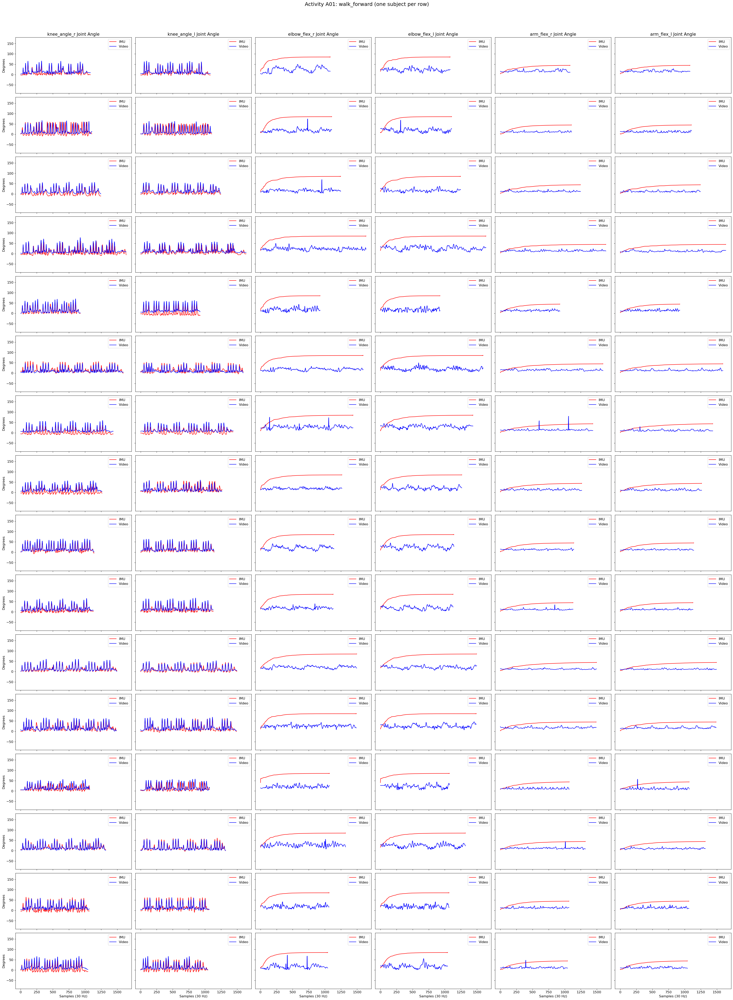

Activity: A02


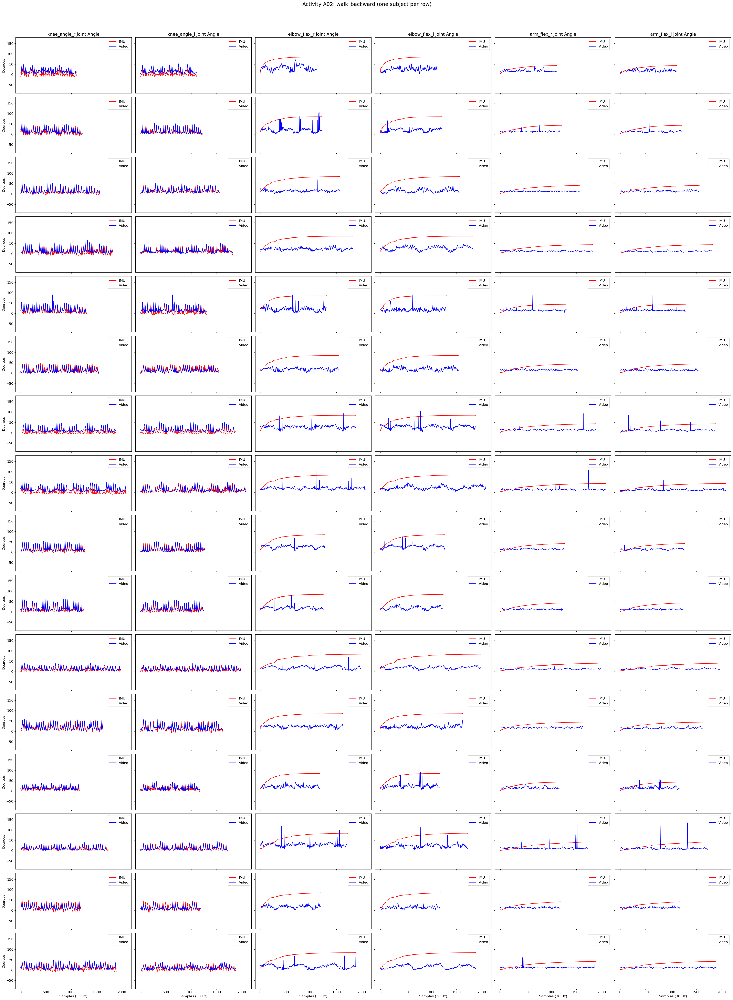

Activity: A03


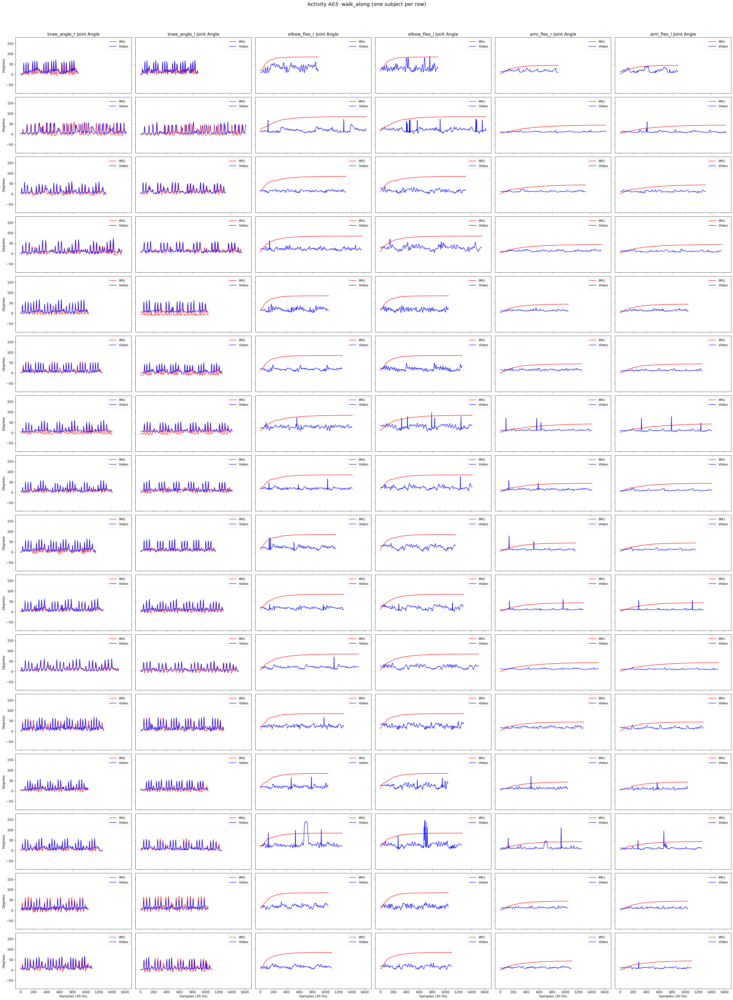

Activity: A04


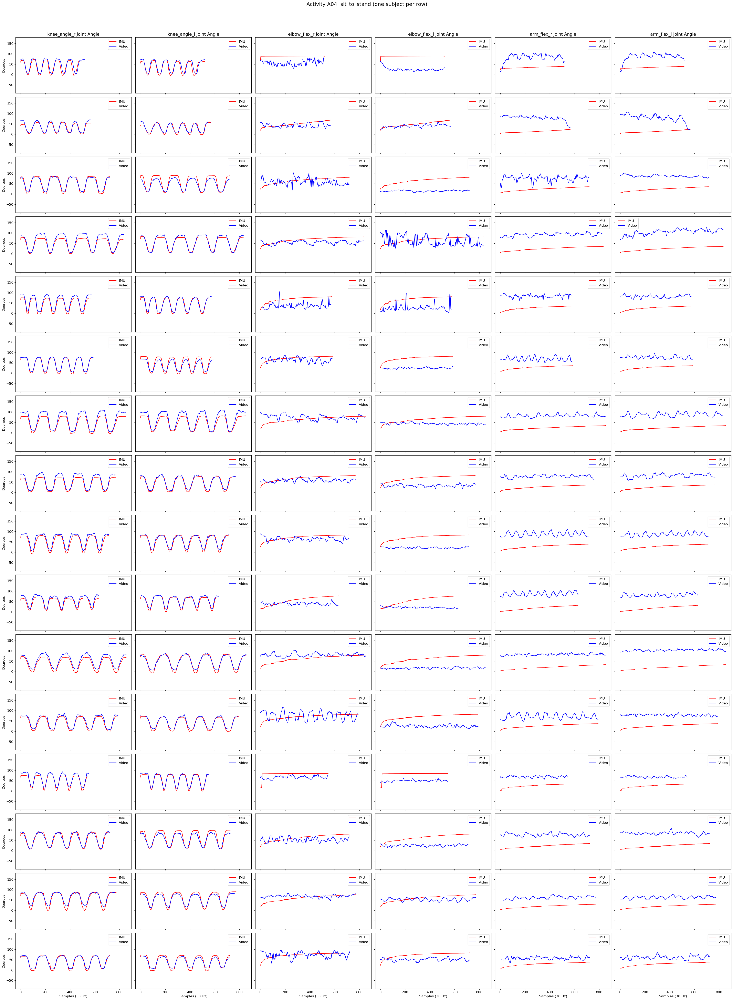

Activity: A05


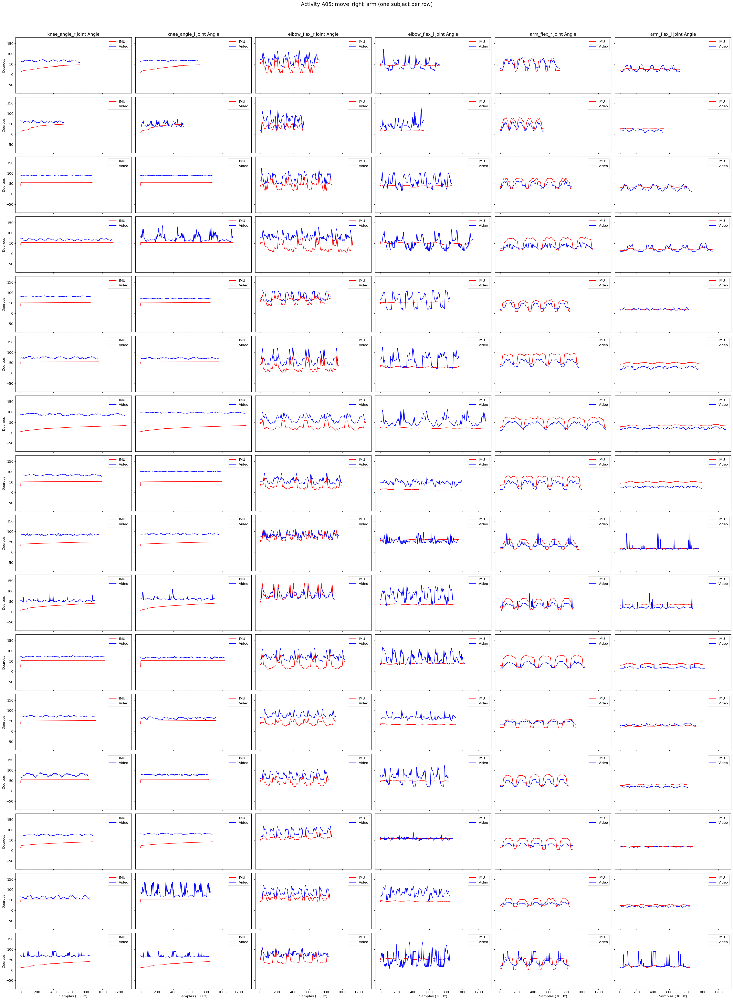

Activity: A06


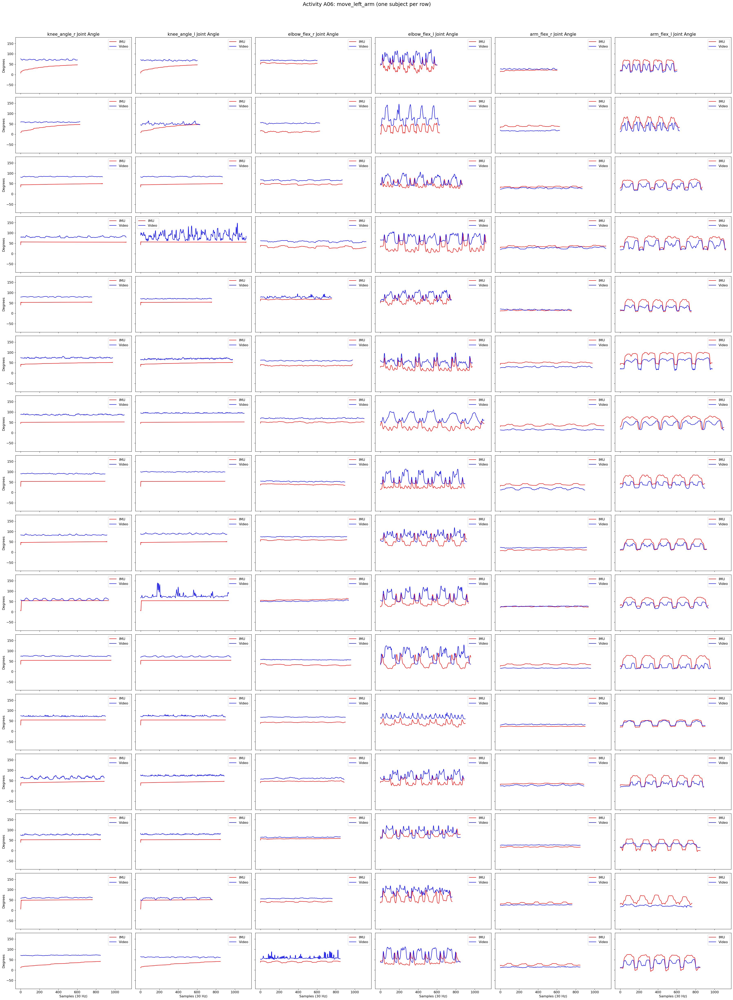

Activity: A07


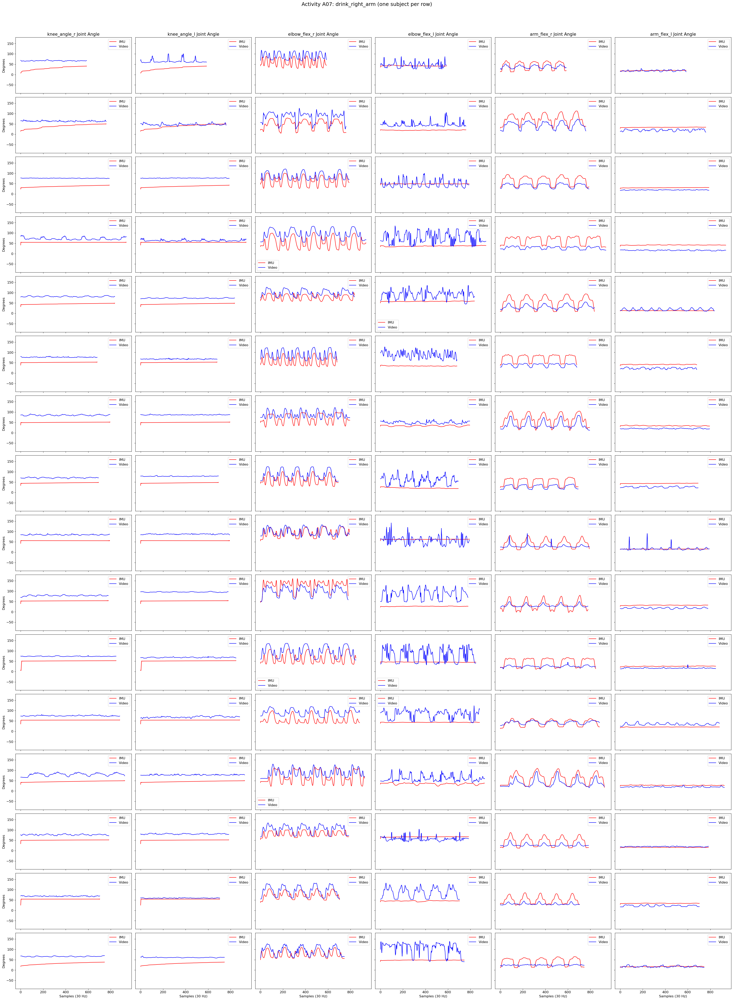

Activity: A08


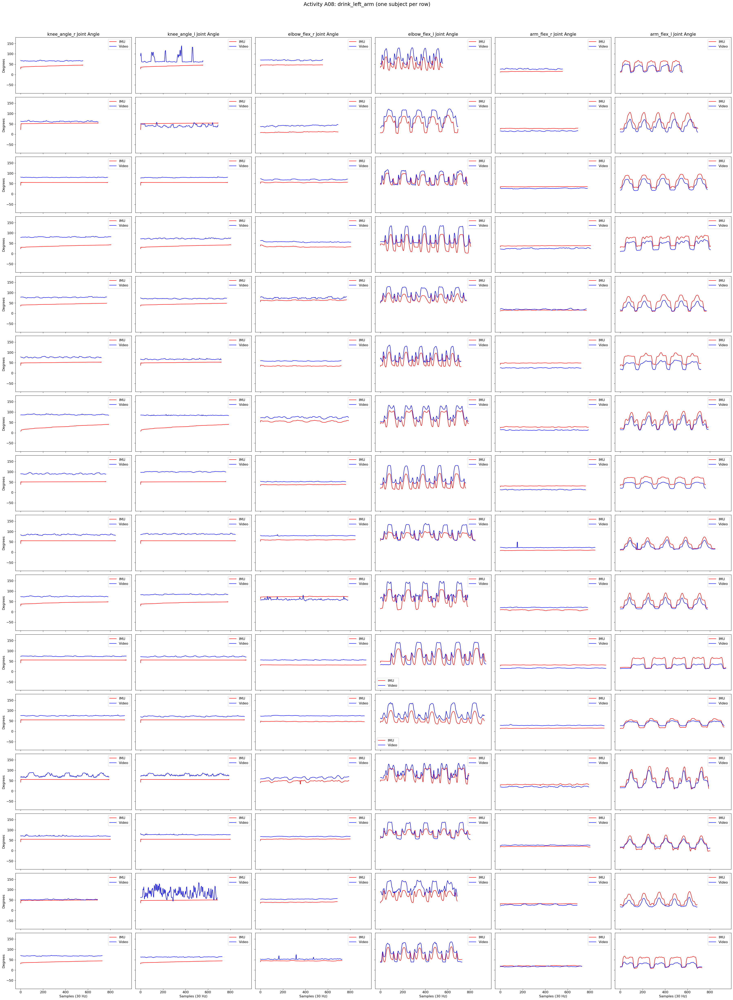

Activity: A09


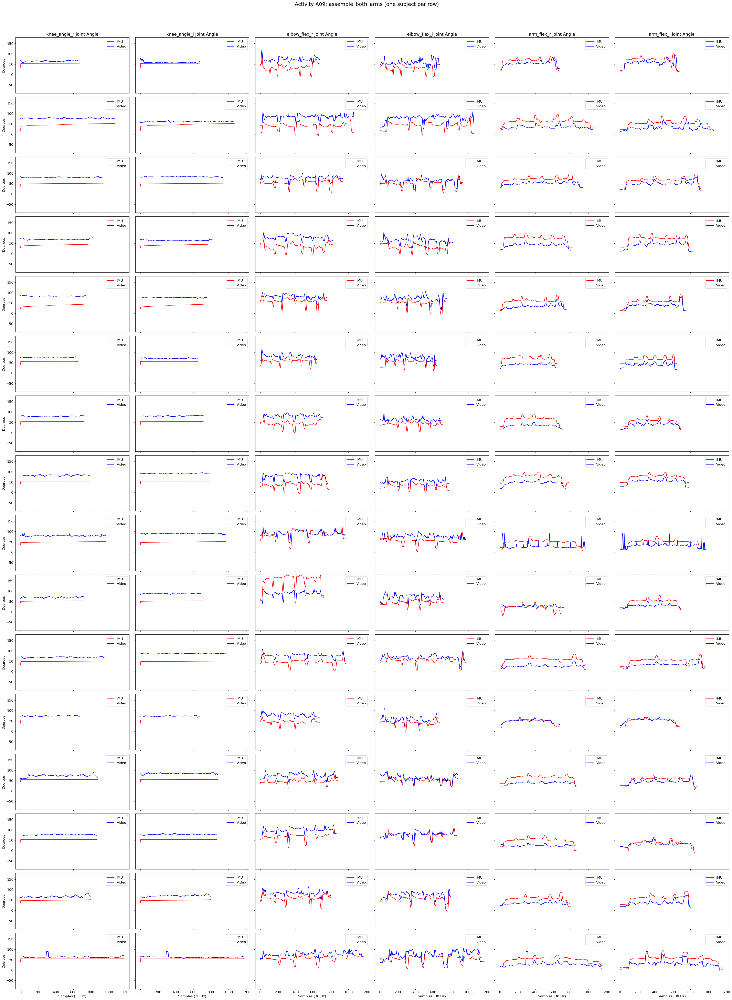

Activity: A10


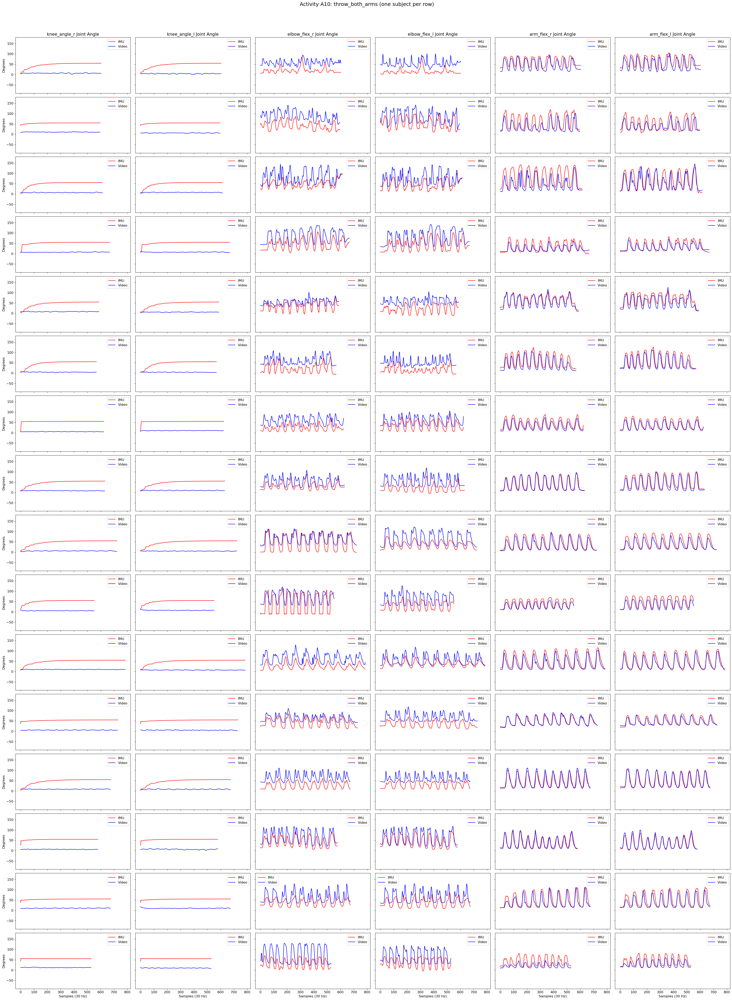

Activity: A11


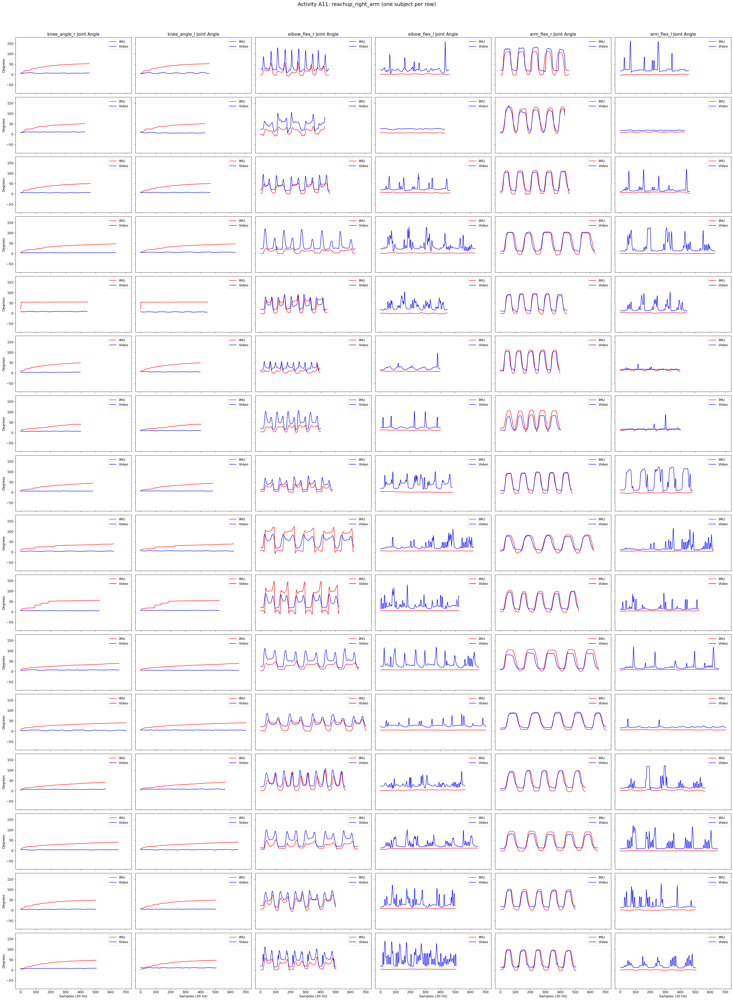

Activity: A12


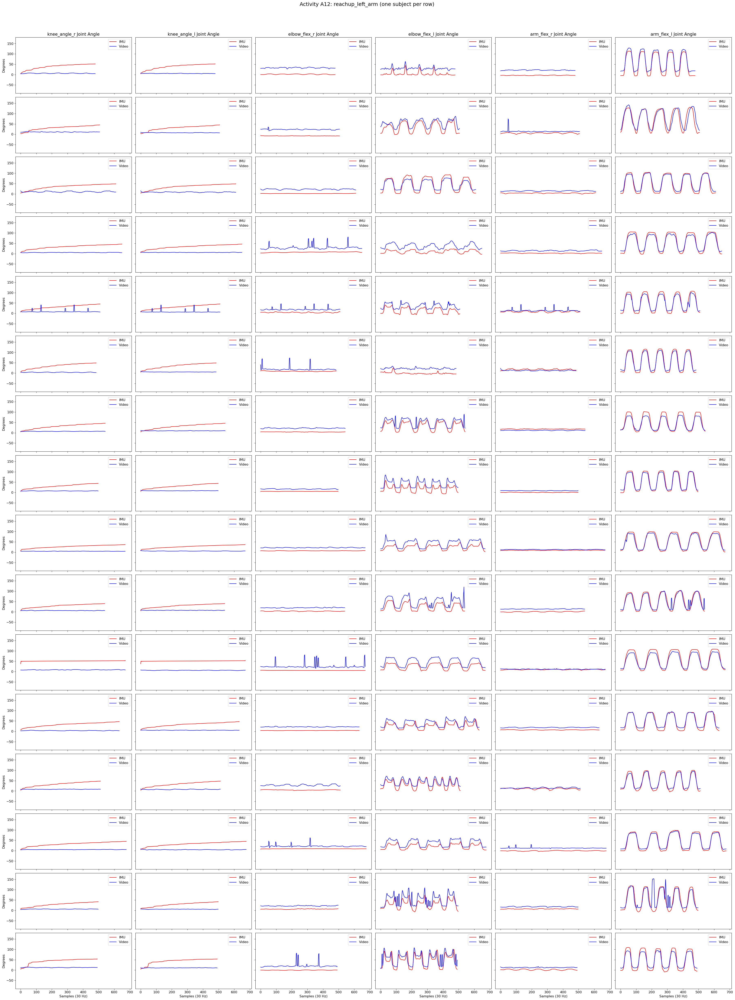

Activity: A13


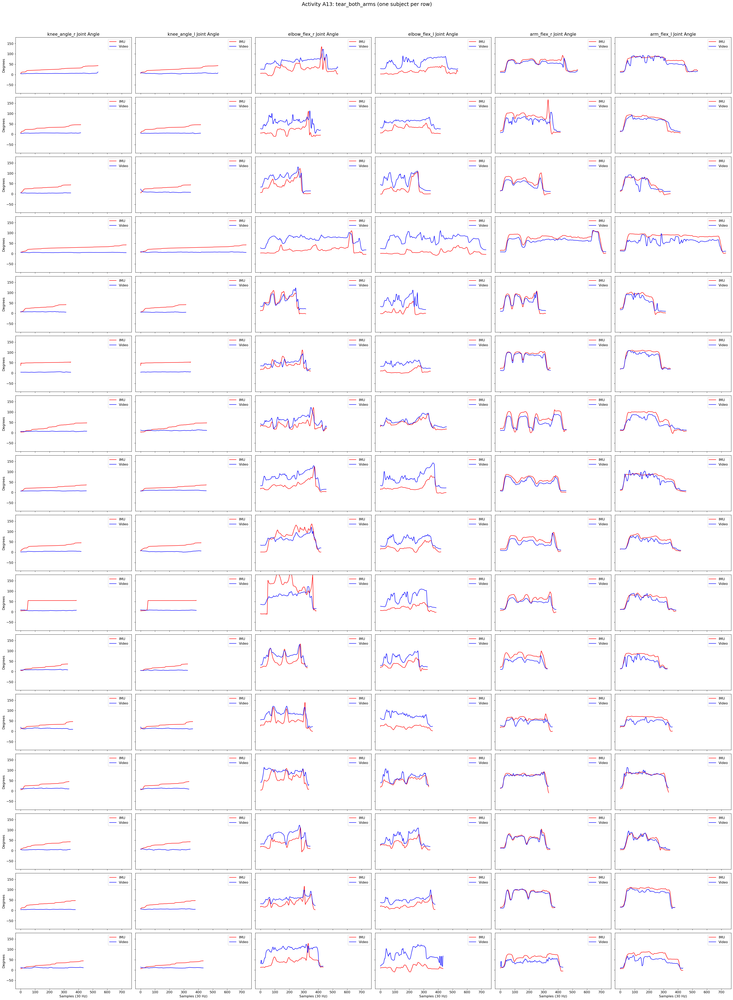

In [43]:
rmse_lists = []
index_activity = 0
outpath=None
# csvlog = 'infoToSync.csv'
csvlogfile = None

inpath = croppath

RMSE_SAMPLES = None
FINAL_LENGTH= 180
# FINAL_LENGTH= None
MAX_SYNC_OVERLAP = 15

for activity, legend in zip(dataset_activities, activities_legend):
    pass
    print("Activity: " + activity)
    rmse_list = plotFramesShiftToSyncrhonizeAllSubjectsOneActivity(inpath, outpath, subjects, activity, legend, None, RMSE_SAMPLES=RMSE_SAMPLES, MAX_SYNC_OVERLAP=MAX_SYNC_OVERLAP, FINAL_LENGTH=FINAL_LENGTH)